# Lending Club Case Study
EPGP in ML & AI - April 2023

***
#### Agenda
This document intends to cover the approach taken for Lending Club Case Study from an Exploratory Data Analysis (EDA) perspective. The document is divided in following high-level sections:
- Problem Statement
- Data Understanding
- Data Cleaning
- Data Analysis
- Recommendations (Prescriptive Insights)

***
#### Problem Statement
A consumer finance company lends various types of loans to urban customers. On reciept of a loan application company makes a decision for loan approval based on applicant's profile. Two types of risks are associated with the bank's decision:
- If the applicant is **likely to repay the loan**, then not approving the loan results in loss of business to the company
- if the applicant is **not likely to repay the loan**, i.e. he/she is likely to default, then approving the loan may lead to financial loss to the company.

##### Objective
In this case study, Exploratory Data Analysis is used to understand how **consumer attributes** and **loan attributes** influence the tendency to default.

***
## Data Understanding

In [124]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

#### Data Understanding - Preliminary Observations

In [125]:
data = pd.read_csv('loan.csv')
data.shape

C:\Users\sabhr\AppData\Local\Temp\ipykernel_16496\2995253119.py:1: DtypeWarning:

Columns (47) have mixed types. Specify dtype option on import or set low_memory=False.



(39717, 111)

In [126]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39717 entries, 0 to 39716
Columns: 111 entries, id to total_il_high_credit_limit
dtypes: float64(74), int64(13), object(24)
memory usage: 33.6+ MB


In [127]:
data.head(10)

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,...,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit
0,1077501,1296599,5000,5000,4975.0,36 months,10.65%,162.87,B,B2,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
1,1077430,1314167,2500,2500,2500.0,60 months,15.27%,59.83,C,C4,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
2,1077175,1313524,2400,2400,2400.0,36 months,15.96%,84.33,C,C5,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
3,1076863,1277178,10000,10000,10000.0,36 months,13.49%,339.31,C,C1,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
4,1075358,1311748,3000,3000,3000.0,60 months,12.69%,67.79,B,B5,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
5,1075269,1311441,5000,5000,5000.0,36 months,7.90%,156.46,A,A4,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
6,1069639,1304742,7000,7000,7000.0,60 months,15.96%,170.08,C,C5,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
7,1072053,1288686,3000,3000,3000.0,36 months,18.64%,109.43,E,E1,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
8,1071795,1306957,5600,5600,5600.0,60 months,21.28%,152.39,F,F2,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
9,1071570,1306721,5375,5375,5350.0,60 months,12.69%,121.45,B,B5,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN


#### Data Understanding - Column Analysis
<table>
    <tr><td>Column Name(s)</td><td>Facts</td><td>Observations / Decision</td></tr>
    <tr>
        <td>‘id’ and ‘member_id’</td>
        <td>These are identifier columns, each row has a unique value for these columns.</td>
        <td>Columns will be dropped for data analysis</td>
    </tr>
    <tr>
        <td>‘loan_status’</td>
        <td>Possible values: Charged Off, Current, Fully Paid.</td>
        <td>This is the target variable. As we are predicting the likelihood of a new loan to be repaid, we will ignore the rows where value of loan status is ‘Current’.</td>
    </tr>
    <tr>
        <td>‘term’</td>
        <td>Unique values for term of the loan is 36 months and 60 months.</td>
        <td>This column is a good candidate for bivariate analysis with other columns.</td>
    </tr>
    <tr>
        <td>‘pymnt_plan’</td>
        <td>Only one possible value: ‘n’.</td>
        <td>Will be dropped for data analysis.</td>
    </tr>
    <tr>
        <td>‘url’ and ‘desc’</td>
        <td>Url represents the link for each loan and desc holds the description of the loan application.</td>
        <td>Will be dropped for data analysis.</td>
    </tr>
    <tr>
        <td>'delinq_2yrs', 'earliest_cr_line', 'inq_last_6mths', 'open_acc', 'pub_rec', 'revol_bal', 'revol_util', 'total_acc', 'out_prncp', 'out_prncp_inv', 'total_pymnt', 'total_pymnt_inv', 'total_rec_prncp', 'total_rec_int', 'total_rec_late_fee', 'recoveries', 'collection_recovery_fee', 'last_pymnt_d', 'last_pymnt_amnt', 'last_credit_pull_d', 'application_type'</td>
        <td>These data points will not be available at the time of loan application.</td>
        <td>Due to unavailability at the time of loan application these data points cannot be used for data analysis related to decisioning for approval or rejection of a loan application.</td>
    </tr>
</table>

In [128]:
data['id'].value_counts()
data['member_id'].value_counts()

1296599    1
731393     1
731544     1
729629     1
731390     1
          ..
989001     1
988993     1
988959     1
988954     1
86999      1
Name: member_id, Length: 39717, dtype: int64

In [129]:
data['loan_amnt'].dtype
data['funded_amnt'].dtype
data['funded_amnt_inv'].dtype

dtype('float64')

In [130]:
data['term'].value_counts()

 36 months    29096
 60 months    10621
Name: term, dtype: int64

In [131]:
data['int_rate'].value_counts()

10.99%    956
13.49%    826
11.49%    825
7.51%     787
7.88%     725
         ... 
18.36%      1
16.96%      1
16.15%      1
16.01%      1
17.44%      1
Name: int_rate, Length: 371, dtype: int64

In [132]:
data['installment'].value_counts()

311.11     68
180.96     59
311.02     54
150.80     48
368.45     46
           ..
1224.46     1
63.44       1
157.67      1
492.34      1
255.43      1
Name: installment, Length: 15383, dtype: int64

***
## Data Cleaning

In [133]:
## removing rows where loan status is 'Current'
data[data['loan_status'] == 'Current']

## 1140 rows have loan status as 'Current'
data = data[data['loan_status'] != 'Current']

In [134]:
## number of rows after removing loans which are current
data.shape

(38577, 111)

In [135]:
## remove the columns not to be used for data analysis
## drop 'id' and 'member_id'
data.drop(['id', 'member_id'], axis=1, inplace=True)

## drop 'pymnt_plan', 'url' and 'desc'
data.drop(['pymnt_plan', 'url', 'desc'], axis=1, inplace=True)

## drop columns not available at the time of loan application
data.drop(['delinq_2yrs', 'earliest_cr_line', 'inq_last_6mths', 'open_acc', 'pub_rec', 'revol_bal', 'revol_util', 'total_acc', 'out_prncp', 'out_prncp_inv', 'total_pymnt', 'total_pymnt_inv', 'total_rec_prncp', 'total_rec_int', 'total_rec_late_fee', 'recoveries', 'collection_recovery_fee', 'last_pymnt_d', 'last_pymnt_amnt', 'last_credit_pull_d', 'application_type'], axis=1, inplace=True)

In [136]:
## Check the data after column removal
data.head(10)

,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,...,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit
0,5000,5000,4975.0,36 months,10.65%,162.87,B,B2,NaN,10+ years,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
1,2500,2500,2500.0,60 months,15.27%,59.83,C,C4,Ryder,< 1 year,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
2,2400,2400,2400.0,36 months,15.96%,84.33,C,C5,NaN,10+ years,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
3,10000,10000,10000.0,36 months,13.49%,339.31,C,C1,AIR RESOURCES BOARD,10+ years,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
5,5000,5000,5000.0,36 months,7.90%,156.46,A,A4,Veolia Transportaton,3 years,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
6,7000,7000,7000.0,60 months,15.96%,170.08,C,C5,Southern Star Photography,8 years,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
7,3000,3000,3000.0,36 months,18.64%,109.43,E,E1,MKC Accounting,9 years,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
8,5600,5600,5600.0,60 months,21.28%,152.39,F,F2,NaN,4 years,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
9,5375,5375,5350.0,60 months,12.69%,121.45,B,B5,Starbucks,< 1 year,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
10,6500,6500,6500.0,60 months,14.65%,153.45,C,C3,Southwest Rural metro,5 years,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN


In [137]:
## Remove '%' at the end of 'int_rate' column values and convert the values to float
data['int_rate'] = data['int_rate'].apply(lambda x : float(x.replace('%', '')))

In [138]:
## Check the 'int_rate' column
data['int_rate'].describe()

count    38577.000000
mean        11.932219
std          3.691327
min          5.420000
25%          8.940000
50%         11.710000
75%         14.380000
max         24.400000
Name: int_rate, dtype: float64

In [139]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 38577 entries, 0 to 39716
Data columns (total 85 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   loan_amnt                       38577 non-null  int64  
 1   funded_amnt                     38577 non-null  int64  
 2   funded_amnt_inv                 38577 non-null  float64
 3   term                            38577 non-null  object 
 4   int_rate                        38577 non-null  float64
 5   installment                     38577 non-null  float64
 6   grade                           38577 non-null  object 
 7   sub_grade                       38577 non-null  object 
 8   emp_title                       36191 non-null  object 
 9   emp_length                      37544 non-null  object 
 10  home_ownership                  38577 non-null  object 
 11  annual_inc                      38577 non-null  float64
 12  verification_status             

In [140]:
## find the list of columns with null values
data.columns[data.isnull().any()]

Index(['emp_title', 'emp_length', 'title', 'mths_since_last_delinq',
       'mths_since_last_record', 'next_pymnt_d', 'collections_12_mths_ex_med',
       'mths_since_last_major_derog', 'annual_inc_joint', 'dti_joint',
       'verification_status_joint', 'tot_coll_amt', 'tot_cur_bal',
       'open_acc_6m', 'open_il_6m', 'open_il_12m', 'open_il_24m',
       'mths_since_rcnt_il', 'total_bal_il', 'il_util', 'open_rv_12m',
       'open_rv_24m', 'max_bal_bc', 'all_util', 'total_rev_hi_lim', 'inq_fi',
       'total_cu_tl', 'inq_last_12m', 'acc_open_past_24mths', 'avg_cur_bal',
       'bc_open_to_buy', 'bc_util', 'chargeoff_within_12_mths',
       'mo_sin_old_il_acct', 'mo_sin_old_rev_tl_op', 'mo_sin_rcnt_rev_tl_op',
       'mo_sin_rcnt_tl', 'mort_acc', 'mths_since_recent_bc',
       'mths_since_recent_bc_dlq', 'mths_since_recent_inq',
       'mths_since_recent_revol_delinq', 'num_accts_ever_120_pd',
       'num_actv_bc_tl', 'num_actv_rev_tl', 'num_bc_sats', 'num_bc_tl',
       'num_il_tl', '

In [141]:
## Find all the columns having no values or all values are missing
data.isnull().sum()[data.isnull().sum() == len(data)].index

Index(['next_pymnt_d', 'mths_since_last_major_derog', 'annual_inc_joint',
       'dti_joint', 'verification_status_joint', 'tot_coll_amt', 'tot_cur_bal',
       'open_acc_6m', 'open_il_6m', 'open_il_12m', 'open_il_24m',
       'mths_since_rcnt_il', 'total_bal_il', 'il_util', 'open_rv_12m',
       'open_rv_24m', 'max_bal_bc', 'all_util', 'total_rev_hi_lim', 'inq_fi',
       'total_cu_tl', 'inq_last_12m', 'acc_open_past_24mths', 'avg_cur_bal',
       'bc_open_to_buy', 'bc_util', 'mo_sin_old_il_acct',
       'mo_sin_old_rev_tl_op', 'mo_sin_rcnt_rev_tl_op', 'mo_sin_rcnt_tl',
       'mort_acc', 'mths_since_recent_bc', 'mths_since_recent_bc_dlq',
       'mths_since_recent_inq', 'mths_since_recent_revol_delinq',
       'num_accts_ever_120_pd', 'num_actv_bc_tl', 'num_actv_rev_tl',
       'num_bc_sats', 'num_bc_tl', 'num_il_tl', 'num_op_rev_tl',
       'num_rev_accts', 'num_rev_tl_bal_gt_0', 'num_sats', 'num_tl_120dpd_2m',
       'num_tl_30dpd', 'num_tl_90g_dpd_24m', 'num_tl_op_past_12m',
     

In [142]:
## Double check values for certain columns found above
# data['verification_status_joint'].value_counts()
data['total_il_high_credit_limit'].value_counts()

Series([], Name: total_il_high_credit_limit, dtype: int64)

In [143]:
## Drop all the columns having no values or columns where all values are missing
data.drop(data.isnull().sum()[data.isnull().sum() == len(data)].index, axis=1, inplace=True)

In [144]:
## Check the dataset after above change
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 38577 entries, 0 to 39716
Data columns (total 30 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   loan_amnt                   38577 non-null  int64  
 1   funded_amnt                 38577 non-null  int64  
 2   funded_amnt_inv             38577 non-null  float64
 3   term                        38577 non-null  object 
 4   int_rate                    38577 non-null  float64
 5   installment                 38577 non-null  float64
 6   grade                       38577 non-null  object 
 7   sub_grade                   38577 non-null  object 
 8   emp_title                   36191 non-null  object 
 9   emp_length                  37544 non-null  object 
 10  home_ownership              38577 non-null  object 
 11  annual_inc                  38577 non-null  float64
 12  verification_status         38577 non-null  object 
 13  issue_d                     385

In [145]:
## Find columns having missing values of the remaining 30 columns
data.isnull().sum()[data.isnull().sum() > 0]

emp_title                      2386
emp_length                     1033
title                            11
mths_since_last_delinq        24905
mths_since_last_record        35837
collections_12_mths_ex_med       56
chargeoff_within_12_mths         56
pub_rec_bankruptcies            697
tax_liens                        39
dtype: int64

In [146]:
## Drop columns mths_since_last_delinq, mths_since_last_record
data.drop(['mths_since_last_delinq', 'mths_since_last_record'], axis=1, inplace=True)

In [147]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 38577 entries, 0 to 39716
Data columns (total 28 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   loan_amnt                   38577 non-null  int64  
 1   funded_amnt                 38577 non-null  int64  
 2   funded_amnt_inv             38577 non-null  float64
 3   term                        38577 non-null  object 
 4   int_rate                    38577 non-null  float64
 5   installment                 38577 non-null  float64
 6   grade                       38577 non-null  object 
 7   sub_grade                   38577 non-null  object 
 8   emp_title                   36191 non-null  object 
 9   emp_length                  37544 non-null  object 
 10  home_ownership              38577 non-null  object 
 11  annual_inc                  38577 non-null  float64
 12  verification_status         38577 non-null  object 
 13  issue_d                     385

In [148]:
data.isnull().sum()[data.isnull().sum() > 0]

emp_title                     2386
emp_length                    1033
title                           11
collections_12_mths_ex_med      56
chargeoff_within_12_mths        56
pub_rec_bankruptcies           697
tax_liens                       39
dtype: int64

In [149]:
## emp_length column missing value addressal - dropping rows where emp_length value is missing
data = data[~data['emp_length'].isnull()]

In [150]:
data.shape

(37544, 28)

In [151]:
## Dropping columns which are not considered for analysis and has any missing values
data.drop(data.isnull().sum()[data.isnull().sum() > 0].index, axis=1, inplace=True)

In [152]:
data.shape

(37544, 22)

In [153]:
## Derive a new column 'result' based on 'loan_status': if status = 'Fully Paid' then 1 else 0
data['result'] = data['loan_status'].apply(lambda x : 1 if (x == 'Fully Paid') else 0)

In [154]:
## Derive a new column 'annual_inc_in_mills' based on 'annual_inc' column holding annual income in millions
data['annual_inc_in_mills'] = data['annual_inc']/1000000

In [155]:
## Derive a new column 'term_months' which holds the integer value from 'term' column
data['term_months'] = data['term'].apply(lambda x : int(x.replace('months', '')))

***
## Data Analysis

In [156]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 37544 entries, 0 to 39716
Data columns (total 25 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   loan_amnt            37544 non-null  int64  
 1   funded_amnt          37544 non-null  int64  
 2   funded_amnt_inv      37544 non-null  float64
 3   term                 37544 non-null  object 
 4   int_rate             37544 non-null  float64
 5   installment          37544 non-null  float64
 6   grade                37544 non-null  object 
 7   sub_grade            37544 non-null  object 
 8   emp_length           37544 non-null  object 
 9   home_ownership       37544 non-null  object 
 10  annual_inc           37544 non-null  float64
 11  verification_status  37544 non-null  object 
 12  issue_d              37544 non-null  object 
 13  loan_status          37544 non-null  object 
 14  purpose              37544 non-null  object 
 15  zip_code             37544 non-null 

In [157]:
## Find all the columns which have null values
data.isnull().sum()[data.isnull().sum() > 0]

Series([], dtype: int64)

In [158]:
## import libraries for plotting graphs
import plotly.offline as py 
py.init_notebook_mode(connected=True) # this code, allow us to work with offline plotly version
import plotly.graph_objs as go # it's like "plt" of matplot
import plotly.tools as tls # It's useful to we get some tools of plotly
import warnings # This library will be used to ignore some warnings
from collections import Counter # To do counter of some features

##### Annual Income Analysis

In [159]:
## describe annual income in millions
data['annual_inc_in_mills'].describe()

count    37544.000000
mean         0.069407
std          0.064677
min          0.004000
25%          0.041000
50%          0.060000
75%          0.083000
max          6.000000
Name: annual_inc_in_mills, dtype: float64

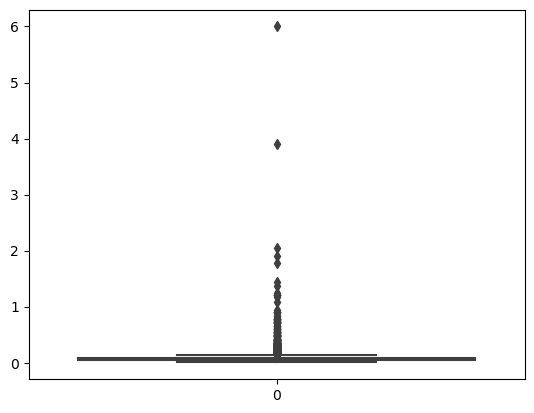

In [160]:
## There is a huge difference between 75 percentile and max value - let's see if there are any outliers
sns.boxplot(data['annual_inc_in_mills'])
plt.show()

In [161]:
## As visible there are certain outliers - let's check how many rows are there where annual income > 1M
data[data['annual_inc_in_mills'] > 1].shape

(14, 25)

In [162]:
## 14 rows are present where annual income > 1M - let's check how many of these 14 loans were 'Charged Off'
data[(data['annual_inc_in_mills'] > 1) & (data['result'] == 0)]

,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_length,home_ownership,...,zip_code,addr_state,dti,initial_list_status,policy_code,acc_now_delinq,delinq_amnt,result,annual_inc_in_mills,term_months
10621,15775,15775,15750.0,60 months,12.99,358.85,C,C1,2 years,MORTGAGE,...,490xx,MI,21.81,f,1,0,0,0,1.25,60


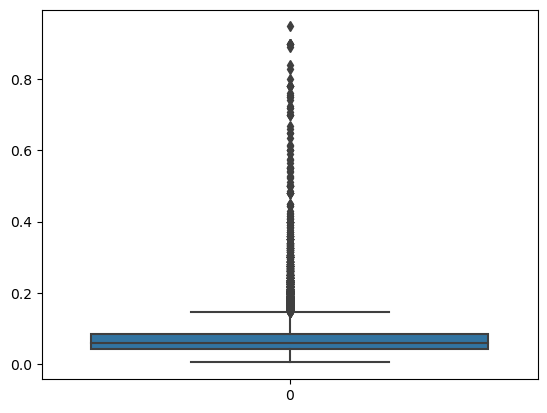

In [163]:
## Only 1 rows is present where annual income > 1M and borrower is not able to pay the loan
## this can be considered as an anamoly
## Also the remaining 13 rows with annual income > 1M can also be ignored as it is skewing the data
## Let's draw a plot without considering these 14 rows
sns.boxplot(data[data['annual_inc_in_mills'] <= 1]['annual_inc_in_mills'])
plt.show()


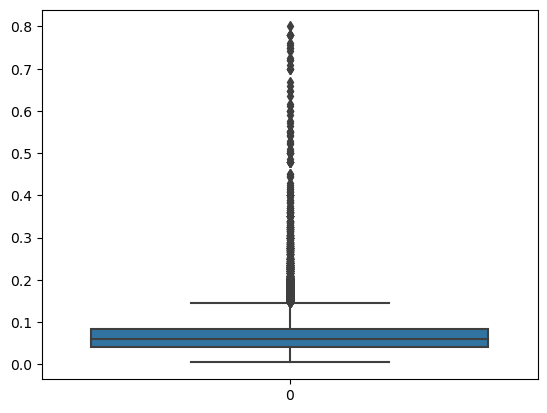

In [164]:
## The result has improved a little but still 25 percentile and 75 percentile data points are very close to each other
## Let's see if this can improved by keeping the upper bound for annual income as .8M
sns.boxplot(data[data['annual_inc_in_mills'] <= 0.8]['annual_inc_in_mills'])
plt.show()

In [165]:
## Let's see how many rows we will need to omit if we keep the upper bound for annual income as .8M
data[data['annual_inc_in_mills'] > 0.8].shape

(22, 25)

In [166]:
## We will loose another 22 rows - let's check how many of these 22 loans are 'Charged Off'
data[(data['annual_inc_in_mills'] > 0.8) & (data['result'] == 0)]

,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_length,home_ownership,...,zip_code,addr_state,dti,initial_list_status,policy_code,acc_now_delinq,delinq_amnt,result,annual_inc_in_mills,term_months
10621,15775,15775,15750.00,60 months,12.99,358.85,C,C1,2 years,MORTGAGE,...,490xx,MI,21.81,f,1,0,0,0,1.25,60
30011,12000,12000,10735.48,36 months,15.33,417.93,D,D3,10+ years,RENT,...,432xx,OH,2.34,f,1,0,0,0,0.84,36


In [97]:
## Let's remove these 22 rows i.e. further analysis 
## will be done considering rows where annual income <= .8M
data = data[data['annual_inc_in_mills'] <= 0.8]
data.shape

(37522, 25)

In [167]:
data_loan_paid_off = data[data['result'] == 1]
data_loan_charged_off = data[data['result'] == 0]

In [168]:
## Let's draw a plot comparing paid off and charged off loans
## We will call paid off loans as 'Good Credit' and charged off loans as 'Bad Credit'
tr0 = go.Bar(
            x = data_loan_paid_off['loan_status'].value_counts().index.values,
            y = data_loan_paid_off['loan_status'].value_counts().values,
            name='Good credit'
    )

tr1 = go.Bar(
            x = data_loan_charged_off['loan_status'].value_counts().index.values,
            y = data_loan_charged_off['loan_status'].value_counts().values,
            name='Bad credit'
    )

all_loans = [tr0, tr1]

layout = go.Layout(
    
)

layout = go.Layout(
    yaxis=dict(
        title='Count'
    ),
    xaxis=dict(
        title='Loan Status'
    ),
    title='Loan Status variable distribution'
)

fig = go.Figure(data=all_loans, layout=layout)

py.iplot(fig, filename='loan-status-bar')

In [276]:
## Let's plot income distribution for Good Credit and Bad Credit
df_good = data_loan_paid_off['annual_inc_in_mills'].values.tolist()
df_bad = data_loan_charged_off['annual_inc_in_mills'].values.tolist()
df_income = data['annual_inc_in_mills'].values.tolist()

#First plot
tr0 = go.Histogram(
    x=df_good,
    name="Good Credit"
)
#Second plot
tr1 = go.Histogram(
    x=df_bad,
    name="Bad Credit"
)
#Third plot
tr2 = go.Histogram(
    x=df_income,
    name="Overall Income"
)

#Creating the grid
fig = tls.make_subplots(rows=2, cols=2, specs=[[{}, {}], [{'colspan': 2}, None]],
                          subplot_titles=('Good','Bad', 'General Distribuition'))

#setting the figs
fig.append_trace(tr0, 1, 1)
fig.append_trace(tr1, 1, 2)
fig.append_trace(tr2, 2, 1)

fig['layout'].update(showlegend=True, title='Annual Income Distribuition', bargap=0.05)
py.iplot(fig, filename='custom-sized-subplot-with-subplot-titles')

**From above we can infer that:**
**- People with annual income in millions between 0 to 0.2 are the largest chunk of borrowers**

In [200]:
## Let's divide the dataset into three - 
## borrowers with annual income between 0 and 0.1 - Low Income borrowers
## borrowers with annual income between 0.1 and 0.2 - Medium Income borrowers
## borrowers with annual income between 0.2 and above - High Income borrowers
## We will create a derived variable 'income_group' using above criteria

,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_length,home_ownership,...,addr_state,dti,initial_list_status,policy_code,acc_now_delinq,delinq_amnt,result,annual_inc_in_mills,term_months,income_group
0,5000,5000,4975.0,36 months,10.65,162.87,B,B2,10+ years,RENT,...,AZ,27.65,f,1,0,0,1,0.024000,36,Low
1,2500,2500,2500.0,60 months,15.27,59.83,C,C4,< 1 year,RENT,...,GA,1.00,f,1,0,0,0,0.030000,60,Low
2,2400,2400,2400.0,36 months,15.96,84.33,C,C5,10+ years,RENT,...,IL,8.72,f,1,0,0,1,0.012252,36,Low
3,10000,10000,10000.0,36 months,13.49,339.31,C,C1,10+ years,RENT,...,CA,20.00,f,1,0,0,1,0.049200,36,Low
5,5000,5000,5000.0,36 months,7.90,156.46,A,A4,3 years,RENT,...,AZ,11.20,f,1,0,0,1,0.036000,36,Low


In [201]:
data[data['income_group'] == 'Low']

,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_length,home_ownership,...,addr_state,dti,initial_list_status,policy_code,acc_now_delinq,delinq_amnt,result,annual_inc_in_mills,term_months,income_group
0,5000,5000,4975.0,36 months,10.65,162.87,B,B2,10+ years,RENT,...,AZ,27.65,f,1,0,0,1,0.024000,36,Low
1,2500,2500,2500.0,60 months,15.27,59.83,C,C4,< 1 year,RENT,...,GA,1.00,f,1,0,0,0,0.030000,60,Low
2,2400,2400,2400.0,36 months,15.96,84.33,C,C5,10+ years,RENT,...,IL,8.72,f,1,0,0,1,0.012252,36,Low
3,10000,10000,10000.0,36 months,13.49,339.31,C,C1,10+ years,RENT,...,CA,20.00,f,1,0,0,1,0.049200,36,Low
5,5000,5000,5000.0,36 months,7.90,156.46,A,A4,3 years,RENT,...,AZ,11.20,f,1,0,0,1,0.036000,36,Low
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39709,5000,5000,675.0,36 months,11.22,164.23,C,C4,< 1 year,OWN,...,WI,1.21,f,1,0,0,1,0.080000,36,Low
39710,5000,5000,250.0,36 months,7.43,155.38,A,A2,1 year,OWN,...,WI,0.31,f,1,0,0,1,0.085000,36,Low
39711,5000,5000,700.0,36 months,8.70,158.30,B,B1,5 years,MORTGAGE,...,CO,15.55,f,1,0,0,1,0.075000,36,Low
39713,8500,8500,875.0,36 months,10.28,275.38,C,C1,3 years,RENT,...,NC,6.40,f,1,0,0,1,0.018000,36,Low


In [277]:
## Let's draw the income distribution plot again for 'Low' income group
## Let's plot income distribution for Good Credit and Bad Credit
low_inc_loan_paid_off = data[(data['result'] == 1) & (data['income_group'] == 'Low')]
low_inc_loan_charged_off = data[(data['result'] == 0) & (data['income_group'] == 'Low')]

df_good = low_inc_loan_paid_off['annual_inc_in_mills'].values.tolist()
df_bad = low_inc_loan_charged_off['annual_inc_in_mills'].values.tolist()
df_income = data[data['income_group'] == 'Low']['annual_inc_in_mills'].values.tolist()

#First plot
tr0 = go.Histogram(
    x=df_good,
    name="Good Credit"
)
#Second plot
tr1 = go.Histogram(
    x=df_bad,
    name="Bad Credit"
)
#Third plot
tr2 = go.Histogram(
    x=df_income,
    name="Overall"
)

#Creating the grid
fig = tls.make_subplots(rows=2, cols=2, specs=[[{}, {}], [{'colspan': 2}, None]],
                          subplot_titles=('Low Income Good Credit','Low Income Bad Credit', 'General Distribuition for Low Income group'))

#setting the figs
fig.append_trace(tr0, 1, 1)
fig.append_trace(tr1, 1, 2)
fig.append_trace(tr2, 2, 1)

fig['layout'].update(showlegend=True, title='Low Annual Income Group Distribuition', bargap=0.05)
py.iplot(fig, filename='custom-sized-subplot-with-subplot-titles')

## Below are the observations from above:
- **There are specific peaks at 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09**
- **There are specific peaks at mid range i.e. 0.035, 0.045, 0.055, 0.065, 0.075 etc.**

## We can infer that - at specific income levels for low income group there is a spurt in the loan offering that is the loan approval is not linearly increasing as the income increases
## We can also infer that - there is a peak at 0.06 millions income level for the number of loans in the low income group

In [173]:
## Let's draw the income distribution plot again for 'Medium' income group
## Let's plot income distribution for Good Credit and Bad Credit
low_inc_loan_paid_off = data[(data['result'] == 1) & (data['income_group'] == 'Medium')]
low_inc_loan_charged_off = data[(data['result'] == 0) & (data['income_group'] == 'Medium')]

df_good = low_inc_loan_paid_off['annual_inc_in_mills'].values.tolist()
df_bad = low_inc_loan_charged_off['annual_inc_in_mills'].values.tolist()
df_income = data[data['income_group'] == 'Medium']['annual_inc_in_mills'].values.tolist()

#First plot
tr0 = go.Histogram(
    x=df_good,
    histnorm='probability',
    name="Good Credit"
)
#Second plot
tr1 = go.Histogram(
    x=df_bad,
    histnorm='probability',
    name="Bad Credit"
)
#Third plot
tr2 = go.Histogram(
    x=df_income,
    histnorm='probability',
    name="Overall"
)

#Creating the grid
fig = tls.make_subplots(rows=2, cols=2, specs=[[{}, {}], [{'colspan': 2}, None]],
                          subplot_titles=('Medium Income Good Credit','Medium Income Bad Credit', 'General Distribuition for Medium Income group'))

#setting the figs
fig.append_trace(tr0, 1, 1)
fig.append_trace(tr1, 1, 2)
fig.append_trace(tr2, 2, 1)

fig['layout'].update(showlegend=True, title='Medium Annual Income Group Distribuition', bargap=0.05)
py.iplot(fig, filename='custom-sized-subplot-with-subplot-titles')

## Below are the observations from above:
- **There are specific peaks at 0.1, 0.11, 0.12, 0.13, 0.14, 0.16**

## We can infer that - at specific income levels for medium income group also there is a spurt in the loan offering
## We can also infer that - as the income is increasing with medium income group number of loans are also decreasing. This can also mean that number of people asking for loans decreases as the income increases.

In [203]:
data[data['income_group'] == 'Low']

,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_length,home_ownership,...,addr_state,dti,initial_list_status,policy_code,acc_now_delinq,delinq_amnt,result,annual_inc_in_mills,term_months,income_group
0,5000,5000,4975.0,36 months,10.65,162.87,B,B2,10+ years,RENT,...,AZ,27.65,f,1,0,0,1,0.024000,36,Low
1,2500,2500,2500.0,60 months,15.27,59.83,C,C4,< 1 year,RENT,...,GA,1.00,f,1,0,0,0,0.030000,60,Low
2,2400,2400,2400.0,36 months,15.96,84.33,C,C5,10+ years,RENT,...,IL,8.72,f,1,0,0,1,0.012252,36,Low
3,10000,10000,10000.0,36 months,13.49,339.31,C,C1,10+ years,RENT,...,CA,20.00,f,1,0,0,1,0.049200,36,Low
5,5000,5000,5000.0,36 months,7.90,156.46,A,A4,3 years,RENT,...,AZ,11.20,f,1,0,0,1,0.036000,36,Low
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39709,5000,5000,675.0,36 months,11.22,164.23,C,C4,< 1 year,OWN,...,WI,1.21,f,1,0,0,1,0.080000,36,Low
39710,5000,5000,250.0,36 months,7.43,155.38,A,A2,1 year,OWN,...,WI,0.31,f,1,0,0,1,0.085000,36,Low
39711,5000,5000,700.0,36 months,8.70,158.30,B,B1,5 years,MORTGAGE,...,CO,15.55,f,1,0,0,1,0.075000,36,Low
39713,8500,8500,875.0,36 months,10.28,275.38,C,C1,3 years,RENT,...,NC,6.40,f,1,0,0,1,0.018000,36,Low


In [312]:
## Let's check low annual income group against loan purpose and sub grade
pd.pivot_table(data=data[data['income_group'] == 'Low'], values='annual_inc_in_mills', index='grade', columns='purpose', aggfunc=np.median)

purpose,car,credit_card,debt_consolidation,educational,home_improvement,house,major_purchase,medical,moving,other,renewable_energy,small_business,vacation,wedding
grade,,,,,,,,,,,,,,
A,0.054000,0.054158,0.052000,0.040000,0.058000,0.058979,0.051998,0.050000,0.05000,0.0510,0.070000,0.052000,0.050000,0.057006
B,0.050700,0.053000,0.052000,0.038500,0.060000,0.061000,0.048000,0.049000,0.04500,0.0500,0.042500,0.058000,0.046000,0.054595
C,0.048000,0.054954,0.051550,0.037000,0.059808,0.047500,0.048000,0.051312,0.04002,0.0450,0.032500,0.055000,0.052582,0.054000
D,0.043702,0.055000,0.054000,0.035780,0.060000,0.059500,0.048000,0.050000,0.04326,0.0450,0.063100,0.057750,0.044000,0.051900
E,0.042798,0.060000,0.057000,0.031054,0.060000,0.048050,0.048000,0.052800,0.04680,0.0470,0.032640,0.060000,0.068400,0.060000
F,0.048500,0.066750,0.060602,0.042500,0.076002,0.044400,0.058300,0.060000,0.03650,0.0528,0.057000,0.057246,0.028800,0.062000
G,0.071800,0.063429,0.063820,0.059356,0.075000,0.070500,0.049116,0.053000,0.02880,0.0580,0.035776,0.060000,0.038480,0.080000


In [226]:
## Let's check low annual income by term in months
#First plot
tr0 = go.Bar(
    x = data[(data['income_group'] == 'Low') & (data['result'] == 1)]['term_months'].value_counts().index.values,
    y = data[(data['income_group'] == 'Low') & (data['result'] == 1)]['term_months'].value_counts().values,
    name='Good credit'
)

#First plot 2
tr1 = go.Bar(
    x = data[(data['income_group'] == 'Low') & (data['result'] == 0)]['term_months'].value_counts().index.values,
    y = data[(data['income_group'] == 'Low') & (data['result'] == 0)]['term_months'].value_counts().values,
    name="Bad Credit"
)

#Second plot
tr2 = go.Box(
    x = data[(data['income_group'] == 'Low') & (data['result'] == 1)]["term_months"],
    y = data[(data['income_group'] == 'Low') & (data['result'] == 1)]["annual_inc_in_mills"],
    name=tr0.name
)

#Second plot 2
tr3 = go.Box(
    x = data[(data['income_group'] == 'Low') & (data['result'] == 0)]["term_months"],
    y = data[(data['income_group'] == 'Low') & (data['result'] == 0)]["annual_inc_in_mills"],
    name=tr1.name
)

all_grade_data = [tr0, tr1, tr2, tr3]


fig = tls.make_subplots(rows=1, cols=2, 
                        subplot_titles=('Term in months Count', 'Annual Income in Millions by Term in months'))

fig.append_trace(tr0, 1, 1)
fig.append_trace(tr1, 1, 1)
fig.append_trace(tr2, 1, 2)
fig.append_trace(tr3, 1, 2)

fig['layout'].update(height=400, width=800, title='Term in months Distribuition', boxmode='group')
py.iplot(fig, filename='Term-in-months-subplot')

C:\Users\sabhr\anaconda3\lib\site-packages\plotly\tools.py:460: DeprecationWarning:

plotly.tools.make_subplots is deprecated, please use plotly.subplots.make_subplots instead



In [271]:
## Let's check low annual income by verification status
#First plot
tr0 = go.Bar(
    x = data[(data['income_group'] == 'Low') & (data['result'] == 1)]['verification_status'].value_counts().index.values,
    y = data[(data['income_group'] == 'Low') & (data['result'] == 1)]['verification_status'].value_counts().values,
    name='Good credit'
)

#First plot 2
tr1 = go.Bar(
    x = data[(data['income_group'] == 'Low') & (data['result'] == 0)]['verification_status'].value_counts().index.values,
    y = data[(data['income_group'] == 'Low') & (data['result'] == 0)]['verification_status'].value_counts().values,
    name="Bad Credit"
)

#Second plot
tr2 = go.Box(
    x = data[(data['income_group'] == 'Low') & (data['result'] == 1)]["verification_status"],
    y = data[(data['income_group'] == 'Low') & (data['result'] == 1)]["annual_inc_in_mills"],
    name=tr0.name
)

#Second plot 2
tr3 = go.Box(
    x = data[(data['income_group'] == 'Low') & (data['result'] == 0)]["verification_status"],
    y = data[(data['income_group'] == 'Low') & (data['result'] == 0)]["annual_inc_in_mills"],
    name=tr1.name
)

all_verification_status_data = [tr0, tr1, tr2, tr3]


fig = tls.make_subplots(rows=1, cols=2, 
                        subplot_titles=('Verification Status Count', 'Annual Income in Millions by Verification Status'))

fig.append_trace(tr0, 1, 1)
fig.append_trace(tr1, 1, 1)
fig.append_trace(tr2, 1, 2)
fig.append_trace(tr3, 1, 2)

fig['layout'].update(height=400, width=800, title='Verification Status Distribuition', boxmode='group')
py.iplot(fig, filename='Verification-Status-subplot')

C:\Users\sabhr\anaconda3\lib\site-packages\plotly\tools.py:460: DeprecationWarning:

plotly.tools.make_subplots is deprecated, please use plotly.subplots.make_subplots instead



In [212]:
bad_credit_data = data[data['result'] == 0]
pivot_result = pd.pivot_table(data=bad_credit_data, index='grade', columns='verification_status', values='annual_inc_in_mills', aggfunc=lambda x: np.quantile(x, 0.2))
pivot_result

verification_status,Not Verified,Source Verified,Verified
grade,,,
A,0.030000,0.030219,0.038690
B,0.030998,0.032000,0.038400
C,0.032584,0.033600,0.039999
D,0.032000,0.034216,0.040000
E,0.032712,0.036000,0.045000
F,0.041935,0.040000,0.053400
G,0.040000,0.030336,0.053600


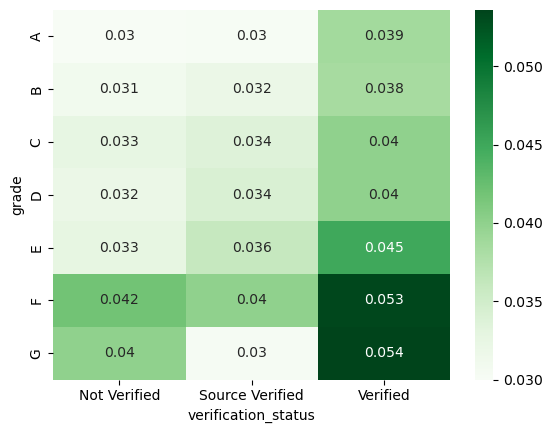

In [214]:
sns.heatmap(pivot_result, cmap='Greens', annot=True)
plt.show()

***
##### Interest Rate Analysis

In [275]:
## Let's plot interest rate distribution for Good Credit and Bad Credit
df_good = data_loan_paid_off['int_rate'].values.tolist()
df_bad = data_loan_charged_off['int_rate'].values.tolist()
df_int_rate = data['int_rate'].values.tolist()

#First plot
tr0 = go.Histogram(
    x=df_good,
    name="Good Credit"
)
#Second plot
tr1 = go.Histogram(
    x=df_bad,
    name="Bad Credit"
)
#Third plot
tr2 = go.Histogram(
    x=df_int_rate,
    name="Overall"
)

#Creating the grid
fig = tls.make_subplots(rows=2, cols=2, specs=[[{}, {}], [{'colspan': 2}, None]],
                          subplot_titles=('Good','Bad', 'General Distribuition'))

#setting the figs
fig.append_trace(tr0, 1, 1)
fig.append_trace(tr1, 1, 2)
fig.append_trace(tr2, 2, 1)

fig['layout'].update(showlegend=True, title='Interest Rate Distribuition', bargap=0.05)
py.iplot(fig, filename='custom-sized-subplot-with-subplot-titles')

In [229]:
data['income_group']

0           Low
1           Low
2           Low
3           Low
5           Low
          ...  
39712    Medium
39713       Low
39714    Medium
39715      High
39716       Low
Name: income_group, Length: 37544, dtype: object

In [230]:
# Let's view interest rate distribution against income groups
data_loan_paid_off = data[data['result'] == 1]
data_loan_charged_off = data[data['result'] == 0]
#First plot
tr0 = go.Bar(
    x = data_loan_paid_off['income_group'].value_counts().index.values,
    y = data_loan_paid_off['income_group'].value_counts().values,
    name='Good credit'
)

#First plot 2
tr1 = go.Bar(
    x = data_loan_charged_off['income_group'].value_counts().index.values,
    y = data_loan_charged_off['income_group'].value_counts().values,
    name="Bad Credit"
)

#Second plot
tr2 = go.Box(
    x = data_loan_paid_off["income_group"],
    y = data_loan_paid_off["int_rate"],
    name=tr0.name
)

#Second plot 2
tr3 = go.Box(
    x = data_loan_charged_off["income_group"],
    y = data_loan_charged_off["int_rate"],
    name=tr1.name
)

all_int_rate_data = [tr0, tr1, tr2, tr3]


fig = tls.make_subplots(rows=1, cols=2, 
                        subplot_titles=('Income Group Count', 'Interest Rate by Income Group'))

fig.append_trace(tr0, 1, 1)
fig.append_trace(tr1, 1, 1)
fig.append_trace(tr2, 1, 2)
fig.append_trace(tr3, 1, 2)

fig['layout'].update(height=400, width=800, title='Income Group Distribuition', boxmode='group')
py.iplot(fig, filename='Income-Group-int-rate-subplot')

C:\Users\sabhr\anaconda3\lib\site-packages\plotly\tools.py:460: DeprecationWarning:

plotly.tools.make_subplots is deprecated, please use plotly.subplots.make_subplots instead



## We can observe that interquartile range for good credit loans is always below the interquartile range for bad credit loans for different income groups
## From above we can infer that higher interest rates loans are more likely to default across income groups

In [305]:
# Let's view interest rate distribution against employment length
data_loan_paid_off = data[data['result'] == 1]
data_loan_charged_off = data[data['result'] == 0]
#First plot
tr0 = go.Bar(
    x = data_loan_paid_off['purpose'].value_counts().index.values,
    y = data_loan_paid_off['purpose'].value_counts().values,
    name='Good credit'
)

#First plot 2
tr1 = go.Bar(
    x = data_loan_charged_off['purpose'].value_counts().index.values,
    y = data_loan_charged_off['purpose'].value_counts().values,
    name="Bad Credit"
)

#Second plot
tr2 = go.Box(
    x = data_loan_paid_off["purpose"],
    y = data_loan_paid_off["int_rate"],
    name=tr0.name
)

#Second plot 2
tr3 = go.Box(
    x = data_loan_charged_off["purpose"],
    y = data_loan_charged_off["int_rate"],
    name=tr1.name
)

all_int_rate_data = [tr0, tr1, tr2, tr3]


fig = tls.make_subplots(rows=1, cols=2, 
                        subplot_titles=('Loan Purpose Count', 'Interest Rate by Loan Purpose'))

fig.append_trace(tr0, 1, 1)
fig.append_trace(tr1, 1, 1)
fig.append_trace(tr2, 1, 2)
fig.append_trace(tr3, 1, 2)

fig['layout'].update(height=400, width=900, title='Loan Purpose Distribuition', boxmode='group')
py.iplot(fig, filename='Employment-Length-int-rate-subplot')

C:\Users\sabhr\anaconda3\lib\site-packages\plotly\tools.py:460: DeprecationWarning:

plotly.tools.make_subplots is deprecated, please use plotly.subplots.make_subplots instead



## Here also we observe across employment length higher interest rate are likely to result in default

In [310]:
## Let's check interest rate against loan purpose and loan amount
pd.pivot_table(data=data, values='int_rate', index='sub_grade', columns='purpose', aggfunc=np.mean)

purpose,car,credit_card,debt_consolidation,educational,home_improvement,house,major_purchase,medical,moving,other,renewable_energy,small_business,vacation,wedding
sub_grade,,,,,,,,,,,,,,
A1,5.955351,5.765345,5.778133,NaN,5.763710,5.808182,5.730000,5.858125,6.135000,5.983107,5.786000,5.747500,5.828000,5.704583
A2,6.386574,6.336966,6.291303,7.238333,6.360170,6.404615,6.436327,6.426667,6.617037,6.642675,6.412500,6.422708,6.233043,6.414167
A3,7.209412,7.116713,7.130580,7.768750,7.160476,7.296154,7.167953,7.195122,7.120233,7.327014,6.920000,7.172712,7.218571,7.069231
A4,7.689580,7.689327,7.586012,8.465312,7.720084,7.727600,7.615876,7.640526,7.744878,7.810567,7.705385,7.677788,7.616296,7.666377
A5,8.267121,8.313676,8.194187,8.861600,8.244842,8.452857,8.139484,8.415128,8.380732,8.408333,7.942500,8.529444,8.000645,8.446338
B1,9.904737,9.985134,10.005229,10.598125,9.959145,10.187619,10.006667,9.987241,10.009286,10.147853,9.817500,9.953889,9.876111,10.043556
B2,10.463596,10.463185,10.498701,10.831429,10.490476,10.306429,10.500230,10.360976,10.532400,10.505810,10.540000,10.422738,10.519333,10.580227
B3,10.771311,11.014571,10.997828,11.051667,10.971833,11.170000,11.006439,11.124889,10.976000,11.009800,10.488333,10.911376,10.750000,10.972923
B4,11.327831,11.466625,11.398811,11.815238,11.343929,11.299545,11.324683,11.239024,11.294500,11.433529,11.461250,11.249451,11.203333,11.422154


In [232]:
# Let's view interest rate distribution against term in months
data_loan_paid_off = data[data['result'] == 1]
data_loan_charged_off = data[data['result'] == 0]
#First plot
tr0 = go.Bar(
    x = data_loan_paid_off['term_months'].value_counts().index.values,
    y = data_loan_paid_off['term_months'].value_counts().values,
    name='Good credit'
)

#First plot 2
tr1 = go.Bar(
    x = data_loan_charged_off['term_months'].value_counts().index.values,
    y = data_loan_charged_off['term_months'].value_counts().values,
    name="Bad Credit"
)

#Second plot
tr2 = go.Box(
    x = data_loan_paid_off["term_months"],
    y = data_loan_paid_off["int_rate"],
    name=tr0.name
)

#Second plot 2
tr3 = go.Box(
    x = data_loan_charged_off["term_months"],
    y = data_loan_charged_off["int_rate"],
    name=tr1.name
)

all_int_rate_data = [tr0, tr1, tr2, tr3]


fig = tls.make_subplots(rows=1, cols=2, 
                        subplot_titles=('Term Count', 'Interest Rate by Term'))

fig.append_trace(tr0, 1, 1)
fig.append_trace(tr1, 1, 1)
fig.append_trace(tr2, 1, 2)
fig.append_trace(tr3, 1, 2)

fig['layout'].update(height=400, width=800, title='Term Distribuition', boxmode='group')
py.iplot(fig, filename='term-int-rate-subplot')

C:\Users\sabhr\anaconda3\lib\site-packages\plotly\tools.py:460: DeprecationWarning:

plotly.tools.make_subplots is deprecated, please use plotly.subplots.make_subplots instead



## For both term types higher interest rate are likely to result in default

In [272]:
# Let's view interest rate distribution against loan purpose
data_loan_paid_off = data[data['result'] == 1]
data_loan_charged_off = data[data['result'] == 0]
#First plot
tr0 = go.Bar(
    x = data_loan_paid_off['purpose'].value_counts().index.values,
    y = data_loan_paid_off['purpose'].value_counts().values,
    name='Good credit'
)

#First plot 2
tr1 = go.Bar(
    x = data_loan_charged_off['purpose'].value_counts().index.values,
    y = data_loan_charged_off['purpose'].value_counts().values,
    name="Bad Credit"
)

#Second plot
tr2 = go.Box(
    x = data_loan_paid_off["purpose"],
    y = data_loan_paid_off["int_rate"],
    name=tr0.name
)

#Second plot 2
tr3 = go.Box(
    x = data_loan_charged_off["purpose"],
    y = data_loan_charged_off["int_rate"],
    name=tr1.name
)

all_int_rate_data = [tr0, tr1, tr2, tr3]


fig = tls.make_subplots(rows=1, cols=2, 
                        subplot_titles=('Term Count', 'Interest Rate by Loan purpose'))

fig.append_trace(tr0, 1, 1)
fig.append_trace(tr1, 1, 1)
fig.append_trace(tr2, 1, 2)
fig.append_trace(tr3, 1, 2)

fig['layout'].update(height=400, width=900, title='Loan purpose Distribuition', boxmode='group')
py.iplot(fig, filename='purpose-int-rate-subplot')

C:\Users\sabhr\anaconda3\lib\site-packages\plotly\tools.py:460: DeprecationWarning:

plotly.tools.make_subplots is deprecated, please use plotly.subplots.make_subplots instead



***
##### Employment Length Analysis

In [278]:
## Let's draw the Employment Length distribution plot for Good Credit and Bad Credit
df_good = data_loan_paid_off['emp_length'].values.tolist()
df_bad = data_loan_charged_off['emp_length'].values.tolist()
df_emp_length = data['emp_length'].values.tolist()

#First plot
tr0 = go.Histogram(
    x=df_good,
    name="Good Credit"
)
#Second plot
tr1 = go.Histogram(
    x=df_bad,
    name="Bad Credit"
)
#Third plot
tr2 = go.Histogram(
    x=df_emp_length,
    name="Overall"
)

#Creating the grid
fig = tls.make_subplots(rows=2, cols=2, specs=[[{}, {}], [{'colspan': 2}, None]],
                          subplot_titles=('Good Credit','Bad Credit', 'General Distribuition for Employment Length'))

#setting the figs
fig.append_trace(tr0, 1, 1)
fig.append_trace(tr1, 1, 2)
fig.append_trace(tr2, 2, 1)

fig['layout'].update(showlegend=True, title='Employment Length Distribuition', bargap=0.05)
py.iplot(fig, filename='custom-sized-subplot-with-subplot-titles')

## Number of loans offered to borrowers with experience of 1 to 5 years is more compared to borrowers with experience of 6 to 9 years

In [269]:
## Let's analyze the data for 10+ year employment length against low income group for Good Credit and Bad Credit
emp_len10yrs_loan_paid_off = data[(data['result'] == 1) & (data['emp_length'] == '10+ years') & (data['income_group'] == 'Low')]
emp_len10yrs_loan_charged_off = data[(data['result'] == 0) & (data['emp_length'] == '10+ years') & (data['income_group'] == 'Low')]

df_good = emp_len10yrs_loan_paid_off['annual_inc_in_mills'].values.tolist()
df_bad = emp_len10yrs_loan_charged_off['annual_inc_in_mills'].values.tolist()
df_emp_len10yrs = data[(data['emp_length'] == '10+ years') & (data['income_group'] == 'Low')]['annual_inc_in_mills'].values.tolist()

#First plot
tr0 = go.Histogram(
    x=df_good,
    histnorm='probability',
    name="Good Credit"
)
#Second plot
tr1 = go.Histogram(
    x=df_bad,
    histnorm='probability',
    name="Bad Credit"
)
#Third plot
tr2 = go.Histogram(
    x=df_emp_len10yrs,
    histnorm='probability',
    name="Overall"
)

#Creating the grid
fig = tls.make_subplots(rows=2, cols=2, specs=[[{}, {}], [{'colspan': 2}, None]],
                          subplot_titles=('Medium Income with 10+ yrs experience','Medium Income with 10+ yrs experience', 'General Distribuition for Medium Income group with 10+ yrs experience'))

#setting the figs
fig.append_trace(tr0, 1, 1)
fig.append_trace(tr1, 1, 2)
fig.append_trace(tr2, 2, 1)

fig['layout'].update(showlegend=True, title='Medium Annual Income Group Distribuition with 10+ yrs experience', bargap=0.05)
py.iplot(fig, filename='custom-sized-subplot-with-subplot-titles')

***
##### Home ownership Analysis

In [176]:
#First plot
tr0 = go.Bar(
    x = data_loan_paid_off["home_ownership"].value_counts().index.values,
    y = data_loan_paid_off["home_ownership"].value_counts().values,
    name='Good credit'
)

#Second plot
tr1 = go.Bar(
    x = data_loan_charged_off["home_ownership"].value_counts().index.values,
    y = data_loan_charged_off["home_ownership"].value_counts().values,
    name="Bad Credit"
)

all_home_ownership_data = [tr0, tr1]

layout = go.Layout(
    title='Home Ownership Distribuition'
)


fig = go.Figure(data=all_home_ownership_data, layout=layout)

py.iplot(fig, filename='Housing-Grouped')

## Most number of loans are offered to borrowers who have either rented or mortgaged the home

In [180]:
data['home_ownership'].value_counts().index[0:2]

Index(['RENT', 'MORTGAGE'], dtype='object')

***
##### Loan Amount Analysis

In [279]:
## Let's plot loan amount distribution for Good Credit and Bad Credit
df_good = data_loan_paid_off['loan_amnt'].values.tolist()
df_bad = data_loan_charged_off['loan_amnt'].values.tolist()
df_income = data['loan_amnt'].values.tolist()

#First plot
tr0 = go.Histogram(
    x=df_good,
    name="Good Credit"
)
#Second plot
tr1 = go.Histogram(
    x=df_bad,
    name="Bad Credit"
)
#Third plot
tr2 = go.Histogram(
    x=df_income,
    name="Overall"
)

#Creating the grid
fig = tls.make_subplots(rows=2, cols=2, specs=[[{}, {}], [{'colspan': 2}, None]],
                          subplot_titles=('Good','Bad', 'General Distribuition'))

#setting the figs
fig.append_trace(tr0, 1, 1)
fig.append_trace(tr1, 1, 2)
fig.append_trace(tr2, 2, 1)

fig['layout'].update(showlegend=True, title='Loan Amount Distribuition', bargap=0.05)
py.iplot(fig, filename='custom-sized-subplot-with-subplot-titles')

In [282]:
## Let's check the top 10 loan amount values
data['loan_amnt'].value_counts().head(10)

10000    2742
12000    2213
5000     1959
6000     1834
15000    1805
8000     1524
20000    1514
25000    1308
4000     1086
7000      984
Name: loan_amnt, dtype: int64

## Majority of the loans approved are from 0 to 10K loan amount range, maximizing at 10K.
## After 10k, the number of loans reduces with reducing peaks at loan amount of 15k, 20k, 25k, 30k and 35k

In [187]:
data_loan_charged_off[data_loan_charged_off["home_ownership"].isin(['MORTGAGE','RENT'])]

,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_length,home_ownership,...,zip_code,addr_state,dti,initial_list_status,policy_code,acc_now_delinq,delinq_amnt,result,annual_inc_in_mills,term_months
1,2500,2500,2500.0,60 months,15.27,59.83,C,C4,< 1 year,RENT,...,309xx,GA,1.00,f,1,0,0,0,0.03000,60
9,5375,5375,5350.0,60 months,12.69,121.45,B,B5,< 1 year,RENT,...,774xx,TX,18.08,f,1,0,0,0,0.01500,60
12,9000,9000,9000.0,36 months,13.49,305.38,C,C1,< 1 year,RENT,...,245xx,VA,10.08,f,1,0,0,0,0.03000,36
14,10000,10000,10000.0,36 months,10.65,325.74,B,B2,3 years,RENT,...,951xx,CA,7.06,f,1,0,0,0,0.10000,36
21,21000,21000,21000.0,36 months,12.42,701.73,B,B4,10+ years,RENT,...,335xx,FL,13.22,f,1,0,0,0,0.10500,36
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39667,2500,2500,675.0,36 months,12.80,84.00,D,D4,< 1 year,MORTGAGE,...,685xx,NE,20.00,f,1,0,0,0,0.03200,36
39668,2500,2500,825.0,36 months,9.64,80.26,B,B4,< 1 year,MORTGAGE,...,685xx,NE,20.00,f,1,0,0,0,0.07500,36
39669,6500,6500,225.0,36 months,15.01,225.37,F,F1,9 years,MORTGAGE,...,300xx,GA,6.45,f,1,0,0,0,0.21300,36
39678,1000,1000,950.0,36 months,10.59,32.55,C,C2,2 years,MORTGAGE,...,245xx,VA,14.47,f,1,0,0,0,0.03399,36


In [189]:
## Let's check loan amount by home ownership (only 'Rent' and 'Mortgage')
rent_mortgage_loan_paid_off = data_loan_paid_off[data_loan_paid_off["home_ownership"].isin(['MORTGAGE','RENT'])]
rent_mortgage_loan_charged_off = data_loan_charged_off[data_loan_charged_off["home_ownership"].isin(['MORTGAGE','RENT'])]
rent_mortgage_loan_data = data[data["home_ownership"].isin(['MORTGAGE','RENT'])]
#First plot
tr0 = go.Bar(
    x = rent_mortgage_loan_paid_off['home_ownership'].value_counts().index.values,
    y = rent_mortgage_loan_paid_off['home_ownership'].value_counts().values,
    name='Good credit'
)

#First plot 2
tr1 = go.Bar(
    x = rent_mortgage_loan_charged_off['home_ownership'].value_counts().index.values,
    y = rent_mortgage_loan_charged_off['home_ownership'].value_counts().values,
    name="Bad Credit"
)

#Second plot
tr2 = go.Box(
    x = rent_mortgage_loan_paid_off["home_ownership"],
    y = rent_mortgage_loan_paid_off["loan_amnt"],
    name=tr0.name
)

#Second plot 2
tr3 = go.Box(
    x = rent_mortgage_loan_charged_off["home_ownership"],
    y = rent_mortgage_loan_charged_off["loan_amnt"],
    name=tr1.name
)

all_rent_mortgage_data = [tr0, tr1, tr2, tr3]


fig = tls.make_subplots(rows=1, cols=2, 
                        subplot_titles=('Home Ownership Count', 'Loan Amount by Home Ownership'))

fig.append_trace(tr0, 1, 1)
fig.append_trace(tr1, 1, 1)
fig.append_trace(tr2, 1, 2)
fig.append_trace(tr3, 1, 2)

fig['layout'].update(height=400, width=800, title='Home Ownership Distribuition', boxmode='group')
py.iplot(fig, filename='Home-Ownership-subplot')

C:\Users\sabhr\anaconda3\lib\site-packages\plotly\tools.py:460: DeprecationWarning:

plotly.tools.make_subplots is deprecated, please use plotly.subplots.make_subplots instead



## From above it can be inferred that - 
- **For both RENT and MORTGAGE home ownership type, higher loan amount can result in bad credit - as is evident by comparing the upper hinge (75th percentile). For both 75th percentile value is much higher for Bad Credit compared to Good Credit**
- **For MORTGAGE home ownership type, interquartile range is bigger compared to RENT. This means that borrowers who already have a mortage (home loan) are more likely to default if the loan amount is higher**

In [196]:
## Let's check loan amount by grade

#First plot
tr0 = go.Bar(
    x = data_loan_paid_off['grade'].value_counts().index.values,
    y = data_loan_paid_off['grade'].value_counts().values,
    name='Good credit'
)

#First plot 2
tr1 = go.Bar(
    x = data_loan_charged_off['grade'].value_counts().index.values,
    y = data_loan_charged_off['grade'].value_counts().values,
    name="Bad Credit"
)

#Second plot
tr2 = go.Box(
    x = data_loan_paid_off["grade"],
    y = data_loan_paid_off["loan_amnt"],
    name=tr0.name
)

#Second plot 2
tr3 = go.Box(
    x = data_loan_charged_off["grade"],
    y = data_loan_charged_off["loan_amnt"],
    name=tr1.name
)

all_grade_data = [tr0, tr1, tr2, tr3]


fig = tls.make_subplots(rows=1, cols=2, 
                        subplot_titles=('Grade Count', 'Loan Amount by Grade'))

fig.append_trace(tr0, 1, 1)
fig.append_trace(tr1, 1, 1)
fig.append_trace(tr2, 1, 2)
fig.append_trace(tr3, 1, 2)

fig['layout'].update(height=400, width=800, title='Grade Distribuition', boxmode='group')
py.iplot(fig, filename='grade-subplot')

C:\Users\sabhr\anaconda3\lib\site-packages\plotly\tools.py:460: DeprecationWarning:

plotly.tools.make_subplots is deprecated, please use plotly.subplots.make_subplots instead



## Grade A loans are less likely to default

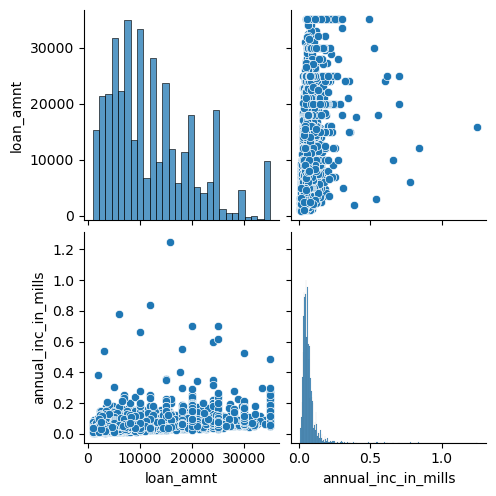

In [194]:
## Create a pair plot for loan amount and Annual Income for bad credit
sns.pairplot(data_loan_charged_off[['loan_amnt','annual_inc_in_mills']])
plt.show()

***
##### Issue Date Analysis

In [224]:
## Let's add two derived columns 'issue_year', 'issue_month' based on issue date column ('issue_d')
data['issue_month'] = pd.DatetimeIndex(data['issue_d'].apply(lambda x : '01-' + x)).month
data['issue_year'] = pd.DatetimeIndex(data['issue_d'].apply(lambda x : '01-' + x)).year

In [225]:
data.head()

,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_length,home_ownership,...,initial_list_status,policy_code,acc_now_delinq,delinq_amnt,result,annual_inc_in_mills,term_months,income_group,issue_month,issue_year
0,5000,5000,4975.0,36 months,10.65,162.87,B,B2,10+ years,RENT,...,f,1,0,0,1,0.024000,36,Low,12,2011
1,2500,2500,2500.0,60 months,15.27,59.83,C,C4,< 1 year,RENT,...,f,1,0,0,0,0.030000,60,Low,12,2011
2,2400,2400,2400.0,36 months,15.96,84.33,C,C5,10+ years,RENT,...,f,1,0,0,1,0.012252,36,Low,12,2011
3,10000,10000,10000.0,36 months,13.49,339.31,C,C1,10+ years,RENT,...,f,1,0,0,1,0.049200,36,Low,12,2011
5,5000,5000,5000.0,36 months,7.90,156.46,A,A4,3 years,RENT,...,f,1,0,0,1,0.036000,36,Low,12,2011


In [233]:
data['issue_year'].value_counts()

2011    19801
2010    11214
2009     4716
2008     1562
2007      251
Name: issue_year, dtype: int64

In [283]:
data['issue_month'].value_counts()

12    4120
11    3890
10    3637
9     3394
8     3321
7     3253
6     3094
5     2838
4     2756
3     2632
1     2331
2     2278
Name: issue_month, dtype: int64

In [284]:
## Let's plot issue month distribution for Good Credit and Bad Credit
data_loan_paid_off = data[data['result'] == 1]
data_loan_charged_off = data[data['result'] == 0]
df_good = data_loan_paid_off['issue_month'].values.tolist()
df_bad = data_loan_charged_off['issue_month'].values.tolist()
df_month = data['issue_month'].values.tolist()

#First plot
tr0 = go.Histogram(
    x=df_good,
    name="Good Credit"
)
#Second plot
tr1 = go.Histogram(
    x=df_bad,
    name="Bad Credit"
)
#Third plot
tr2 = go.Histogram(
    x=df_month,
    name="Overall"
)

#Creating the grid
fig = tls.make_subplots(rows=2, cols=2, specs=[[{}, {}], [{'colspan': 2}, None]],
                          subplot_titles=('Good','Bad', 'General Distribuition'))

#setting the figs
fig.append_trace(tr0, 1, 1)
fig.append_trace(tr1, 1, 2)
fig.append_trace(tr2, 2, 1)

fig['layout'].update(showlegend=True, title='Issue Month Distribuition', bargap=0.05)
py.iplot(fig, filename='custom-sized-subplot-with-subplot-titles')

C:\Users\sabhr\anaconda3\lib\site-packages\plotly\tools.py:460: DeprecationWarning:

plotly.tools.make_subplots is deprecated, please use plotly.subplots.make_subplots instead



## As we can observe, loans application approved keeps on increasing month-on-month, being lowest in Jan and Feb
## One reason for this almost linear increase may be to due to pressure to achieve yearly sales target 

In [285]:
## Let's plot Loan Purpose distribution for Good Credit and Bad Credit
data_loan_paid_off = data[data['result'] == 1]
data_loan_charged_off = data[data['result'] == 0]
df_good = data_loan_paid_off['purpose'].values.tolist()
df_bad = data_loan_charged_off['purpose'].values.tolist()
df_month = data['purpose'].values.tolist()

#First plot
tr0 = go.Histogram(
    x=df_good,
    name="Good Credit"
)
#Second plot
tr1 = go.Histogram(
    x=df_bad,
    name="Bad Credit"
)
#Third plot
tr2 = go.Histogram(
    x=df_month,
    name="Overall"
)

#Creating the grid
fig = tls.make_subplots(rows=2, cols=2, specs=[[{}, {}], [{'colspan': 2}, None]],
                          subplot_titles=('Good','Bad', 'General Distribuition'))

#setting the figs
fig.append_trace(tr0, 1, 1)
fig.append_trace(tr1, 1, 2)
fig.append_trace(tr2, 2, 1)

fig['layout'].update(showlegend=True, title='Loan Purpose Distribuition', bargap=0.05)
py.iplot(fig, filename='custom-sized-subplot-with-subplot-titles')

In [295]:
data['purpose'].value_counts()[1:].sum()

19869

## As we can observe maximum number of loans furnished is for the purpose of debt considation, with next two purposes for loans being credit card and others

***
##### dti (Debt to Income ratio) Variable Analysis

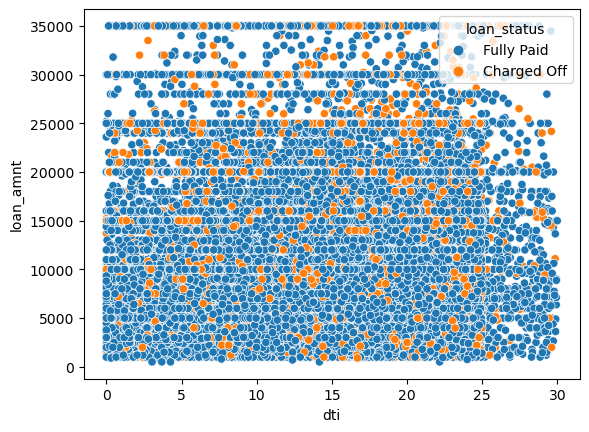

In [247]:
## Let's analyze dti against loan amount
## Understanding of dti is how much of a customer's income goes towards fullfilling current debt
## As a guideline it is recommended that dti should be lower than 36%
## Ideally, a person having a high value of dti should not be given a high loan amount
## let's draw a scatter plot between dti and loan amount
sns.scatterplot(data=data, x='dti', y='loan_amnt', hue='loan_status')
plt.show()

In [262]:
## Let's plot dti distribution for Good Credit and Bad Credit
data_loan_paid_off = data[data['result'] == 1]
data_loan_charged_off = data[data['result'] == 0]
df_good = data_loan_paid_off['dti'].values.tolist()
df_bad = data_loan_charged_off['dti'].values.tolist()
df_dti = data['dti'].values.tolist()

#First plot
tr0 = go.Histogram(
    x=df_good,
    histnorm='probability',
    name="Good Credit"
)
#Second plot
tr1 = go.Histogram(
    x=df_bad,
    histnorm='probability',
    name="Bad Credit"
)
#Third plot
tr2 = go.Histogram(
    x=df_dti,
    histnorm='probability',
    name="Overall"
)

#Creating the grid
fig = tls.make_subplots(rows=2, cols=2, specs=[[{}, {}], [{'colspan': 2}, None]],
                          subplot_titles=('Good','Bad', 'General Distribuition'))

#setting the figs
fig.append_trace(tr0, 1, 1)
fig.append_trace(tr1, 1, 2)
fig.append_trace(tr2, 2, 1)

fig['layout'].update(showlegend=True, title='Debt to Income Distribuition', bargap=0.05)
py.iplot(fig, filename='custom-sized-subplot-with-subplot-titles')

C:\Users\sabhr\anaconda3\lib\site-packages\plotly\tools.py:460: DeprecationWarning:

plotly.tools.make_subplots is deprecated, please use plotly.subplots.make_subplots instead



In [263]:
## let's create a derived variable from 'dti' called 'dti_group'
## 0 <= dti < 5 - very low; 5 <= dti < 10 - low; 10 <= dti < 15 - medium; 15 <= dti < 20 - high; 20 <= dti < 25 - very high; 
## 25 <= dti - extremely high;
data['dti_group'] = data['dti'].apply(lambda x : 'Very Low' if ((x >= 0) & (x < 5)) else 'Low' if ((x >= 5) & (x < 10)) else 'Medium' if ((x >= 10) & (x < 15)) else 'High' if ((x >= 15) & (x < 20)) else 'Very High' if ((x >= 20) & (x < 25)) else 'Extremely High')
data.head()

,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_length,home_ownership,...,policy_code,acc_now_delinq,delinq_amnt,result,annual_inc_in_mills,term_months,income_group,issue_month,issue_year,dti_group
0,5000,5000,4975.0,36 months,10.65,162.87,B,B2,10+ years,RENT,...,1,0,0,1,0.024000,36,Low,12,2011,Extremely High
1,2500,2500,2500.0,60 months,15.27,59.83,C,C4,< 1 year,RENT,...,1,0,0,0,0.030000,60,Low,12,2011,Very Low
2,2400,2400,2400.0,36 months,15.96,84.33,C,C5,10+ years,RENT,...,1,0,0,1,0.012252,36,Low,12,2011,Low
3,10000,10000,10000.0,36 months,13.49,339.31,C,C1,10+ years,RENT,...,1,0,0,1,0.049200,36,Low,12,2011,Very High
5,5000,5000,5000.0,36 months,7.90,156.46,A,A4,3 years,RENT,...,1,0,0,1,0.036000,36,Low,12,2011,Medium


In [301]:
## Let's analyze the dti_group against loan amount
data_loan_paid_off = data[data['result'] == 1]
data_loan_charged_off = data[data['result'] == 0]
#First plot
tr0 = go.Bar(
    x = data_loan_paid_off['dti_group'].value_counts().index.values,
    y = data_loan_paid_off['dti_group'].value_counts().values,
    name='Good credit'
)

#First plot 2
tr1 = go.Bar(
    x = data_loan_charged_off['dti_group'].value_counts().index.values,
    y = data_loan_charged_off['dti_group'].value_counts().values,
    name="Bad Credit"
)

#Second plot
tr2 = go.Box(
    x = data_loan_paid_off["dti_group"],
    y = data_loan_paid_off["loan_amnt"],
    name=tr0.name
)

#Second plot 2
tr3 = go.Box(
    x = data_loan_charged_off["dti_group"],
    y = data_loan_charged_off["loan_amnt"],
    name=tr1.name
)

all_grade_data = [tr0, tr1, tr2, tr3]


fig = tls.make_subplots(rows=1, cols=2, 
                        subplot_titles=('DTI Group Count', 'Loan Amount by DTI Group'))

fig.append_trace(tr0, 1, 1)
fig.append_trace(tr1, 1, 1)
fig.append_trace(tr2, 1, 2)
fig.append_trace(tr3, 1, 2)

fig['layout'].update(height=400, width=900, title='DTI Group Distribuition', boxmode='group')
py.iplot(fig, filename='DTI-Group-subplot')

C:\Users\sabhr\anaconda3\lib\site-packages\plotly\tools.py:460: DeprecationWarning:

plotly.tools.make_subplots is deprecated, please use plotly.subplots.make_subplots instead



In [296]:
data['dti_group'].value_counts()

Medium            9394
High              8614
Low               7643
Very High         6421
Very Low          4874
Extremely High     598
Name: dti_group, dtype: int64

In [302]:
dti_group_stacked = pd.pivot_table(data=data[data['income_group'] == 'Low'], values='annual_inc_in_mills', index='dti_group', columns='loan_status', aggfunc=sum)

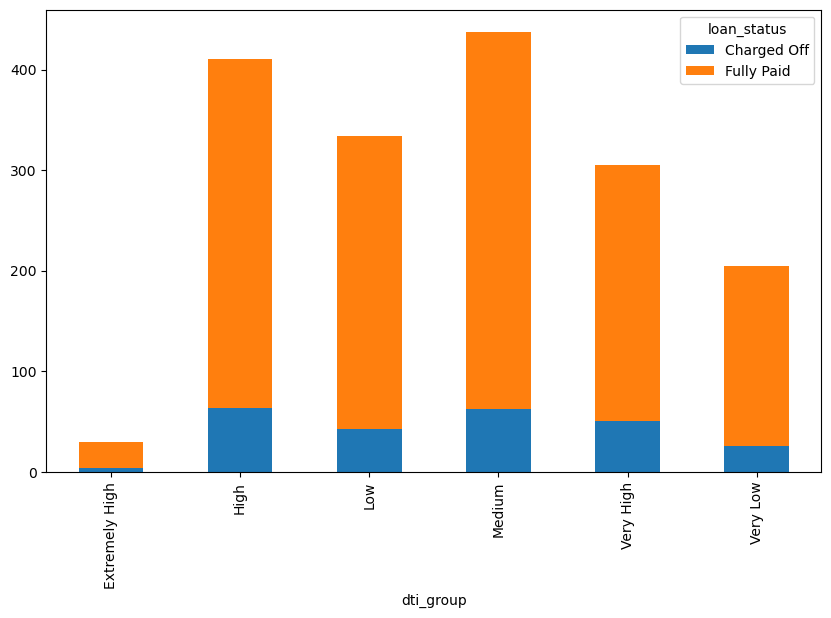

In [303]:
dti_group_stacked.plot(kind='bar', stacked=True, figsize=[10,6])
plt.show()